In [2]:
from bigfish import stack
import os
import bigfish
from pathlib import Path
from tqdm import tqdm
import tkinter as tk
from tkinter import filedialog

In [12]:
#Function for reading image
def read_img():
    root = tk.Tk()
    root.withdraw()
    img_path = filedialog.askopenfilename()
    img_name = img_path.split("/")
    img_name = img_name[-1]
    img = stack.read_image(img_path)
    print("\r shape: {0}".format(img.shape))
    print("\r dtype: {0}".format(img.dtype))
    return (img, img_name)

In [26]:
#Function for creating seperate image channels
def seperate_channels(img, img_name):    
    #Sorted shape
    sorted_shape = sorted([i for i in img.shape])
    n_channels = sorted_shape[0]
    print('This image has {} channels'.format(n_channels))
    z_slices = sorted_shape[1]
    print('This image has {} z-slices'.format(z_slices))
    pixels_x = sorted_shape[2]
    print('This image has {} pixels on the x-axis'.format(pixels_x))
    pixels_y = sorted_shape[3]
    print('This image has {} pixels on the y-axis'.format(pixels_y))
    
    #channel segmentation
    n_channels = sorted_shape[0]
    parentDirectory = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
    directory = os.path.join(parentDirectory, 'FISH_SEARCH', 'data')
    for i in range(n_channels):
        save_name = f"/channel{i}_{img_name}"
        if n_channels == 3:
            channel = img[:,:,:,i]
            stack.save_image(channel,parentDirectory + save_name)
        if n_channels == 2:
            channel = img[:,i,:,:] # 2 channel
            stack.save_image(channel,parentDirectory + save_name)

In [14]:
import bigfish.plot as plot

def generate_projections(img):
    # Define DAPI Channel
    DAPI_3D = img[:,0,:,:]
    DAPI_2D = stack.maximum_projection(DAPI_3D)

    # Probe Channel
    RNA_3D = img[:,1,:,:]
    RNA_2D = stack.maximum_projection(RNA_3D)
    
    images = [DAPI_2D, RNA_2D]
    bigfish.plot.plot_images(images,rescale=True, contrast=True)
    
    return [DAPI_3D, DAPI_2D, RNA_3D, RNA_2D]

In [15]:
from cellpose import models
from matplotlib import pyplot as plt
from cellpose import plot as plt2
import pandas as pd
import numpy as np
import bigfish.segmentation as segmentation

def cell_nuc_segmentation(DAPI_2D, RNA_3D, RNA_2D, diam = 100, thresh=40):
    model = models.Cellpose(gpu=False,model_type='cyto')
    channels = [[3,3]]
    masks, flows, styles, diams = model.eval(DAPI_2D, diameter=diam, channels=channels, do_3D=False)
    
    ##display of results
    fig = plt.figure(figsize=(50,50))
    plt2.show_segmentation(fig, DAPI_2D, masks, flows[0], channels=[[3,0]])
    plt.tight_layout()
    plt.show()
    
    ##segement nucleus and cells
    nuc_label = np.int64(masks)
    cell_label = segmentation.cell_watershed(RNA_3D, nuc_label, threshold=thresh, alpha=0.95)
    
    # Plot the labelled nuclei and cells
    bigfish.plot.plot_segmentation_boundary(RNA_2D, cell_label, nuc_label, framesize=(40, 40), contrast=True, boundary_size=2)
    
    return (nuc_label, cell_label)

In [16]:
def rsfish_analysis(RNA_2D):
    root = tk.Tk()
    root.withdraw()
    csv_path = filedialog.askopenfilename()
    csv_name = csv_path.split("/")
    csv_name = csv_name[-1]
    
    df = df = pd.read_csv(csv_path)
    intensity_values = df['intensity'].tolist()
    spotIntensity(intensity_values)
    df = df.drop(['intensity','t','c'], axis =1)
    df = df[['y','x']]
    rs_spots = df.loc[:, :].values.tolist()
    rs_spots = np.array(rs_spots)
    plot.plot_detection(RNA_2D, rs_spots, contrast=True,framesize=(40, 40))
    return rs_spots

In [43]:
import bigfish.multistack as multistack
def cell_extraction(nuc_label, rs_spots, RNA_2D):
    spots_in, spots_out = multistack.identify_objects_in_region(nuc_label, rs_spots, ndim=2)
    fov_results = multistack.extract_cell(
    cell_label=cell_label, 
    ndim=2, 
    nuc_label=nuc_label, 
    rna_coord=rs_spots, 
    image=RNA_2D)
    
    print("detected spots (inside nuclei)")
    print("\r shape: {0}".format(spots_in.shape))
    print("\r dtype: {0}".format(spots_in.dtype), "\n")
    print("detected spots (outside nuclei)")
    print("\r shape: {0}".format(spots_out.shape))
    print("\r dtype: {0}".format(spots_out.dtype))
    print("number of cells identified: {0}".format(len(fov_results)))
    return fov_results

In [38]:
def cell_level_visualization(fov_results):
    for i, cell_results in enumerate(fov_results):
        # print("cell {0}".format(i))

        # get cell results
        cell_mask = cell_results["cell_mask"]
        cell_coord = cell_results["cell_coord"]
        nuc_mask = cell_results["nuc_mask"]
        nuc_coord = cell_results["nuc_coord"]
        rna_coord = cell_results["rna_coord"]
        image_contrasted = cell_results["image"]
        # print("\r number of rna {0}".format(len(rna_coord)))

        #plot cell
        plot.plot_cell(
            ndim=2, cell_coord=cell_coord, nuc_coord=nuc_coord, 
            rna_coord=rna_coord, 
            image=image_contrasted, cell_mask=cell_mask, nuc_mask=nuc_mask, 
            title="Cell {0}".format(i))

In [67]:
def spotCount(fov_results, img_name):
    averageCount = []
    img_name = img_name.split('.tif')
    img_name = img_name[0]
    for i, cell_results in enumerate(fov_results):
        # print("cell {0}".format(i))

        # get cell results
        cell_mask = cell_results["cell_mask"]
        cell_coord = cell_results["cell_coord"]
        nuc_mask = cell_results["nuc_mask"]
        nuc_coord = cell_results["nuc_coord"]
        rna_coord = cell_results["rna_coord"]
        image_contrasted = cell_results["image"]
        averageCount.append(len(rna_coord))
        
    spotCountCSV = pd.DataFrame(averageCount)
    spotCountCSV.to_csv(f'{os.path.abspath(os.path.join(os.getcwd(), os.pardir))}/data/graph_data/cellSpotCount_{img_name}.csv', index=False)

In [78]:
def maxMinCount(fov_results, img_name):
    max = int()
    min = int()
    img_name = img_name.split('.tif')
    img_name = img_name[0]
    
    for i, cell_results in enumerate(fov_results):
        # print("cell {0}".format(i))

        # get cell results
        cell_mask = cell_results["cell_mask"]
        cell_coord = cell_results["cell_coord"]
        nuc_mask = cell_results["nuc_mask"]
        nuc_coord = cell_results["nuc_coord"]
        rna_coord = cell_results["rna_coord"]
        image_contrasted = cell_results["image"]
        count = len(rna_coord)
        
        if count > max:
            max = count
        if count < min:
            min = count
            
    limitCountCSV = pd.DataFrame([max, min])
    limitCountCSV.to_csv(f'{os.path.abspath(os.path.join(os.getcwd(), os.pardir))}/data/graph_data/cellSpotLimits_{img_name}.csv', index=False)     

In [80]:
def spotIntensity(intensity_values):
    spotIntensities = pd.DataFrame(intensity_values)
    spotIntensities.to_csv(f'{os.path.abspath(os.path.join(os.getcwd(), os.pardir))}/data/graph_data/spotIntensities{img_name}.csv', index=False)

## Testing

In [19]:
img, img_name = read_img()

 shape: (15, 2, 2048, 2048)
 dtype: uint16


In [27]:
seperate_channels(img, img_name)

This image has 2 channels
This image has 15 z-slices
This image has 2048 pixels on the x-axis
This image has 2048 pixels on the y-axis


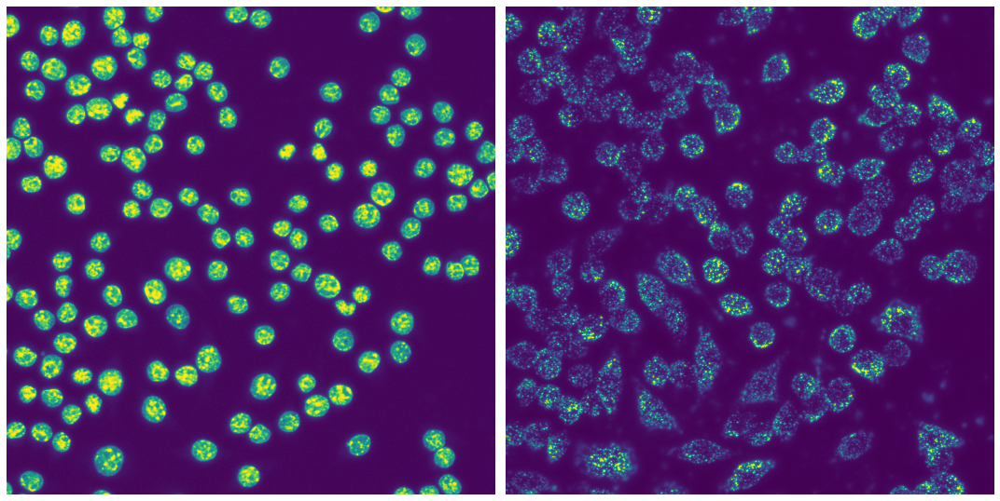

In [28]:
views = generate_projections(img)
DAPI_3D = views[0]
DAPI_2D = views[1]
RNA_3D = views[2]
RNA_2D = views[3]

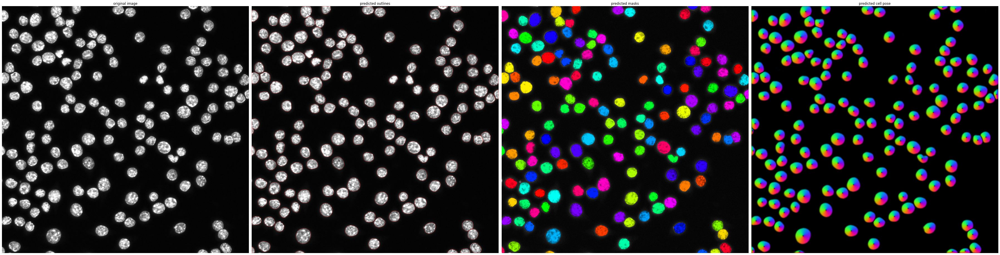

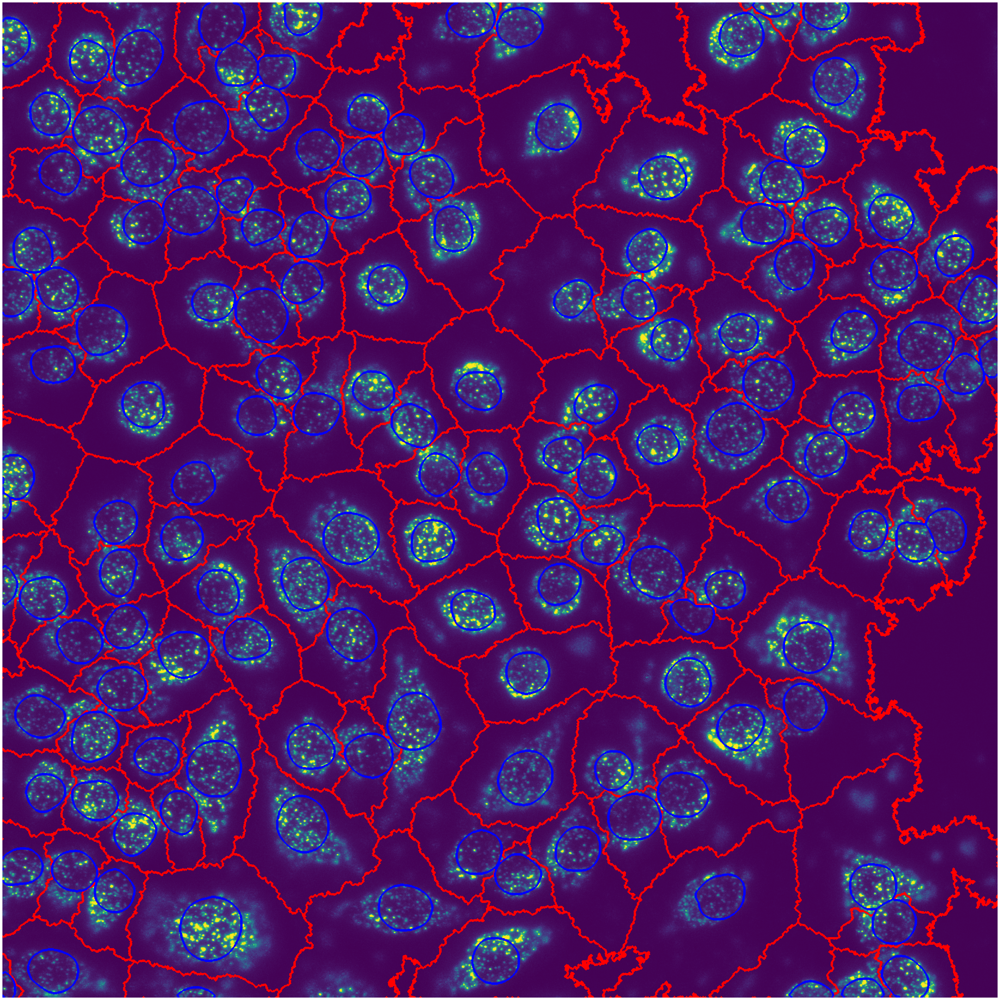

In [29]:
nuc_label, cell_label = cell_nuc_segmentation(DAPI_2D, RNA_3D, RNA_2D, 100, 40)

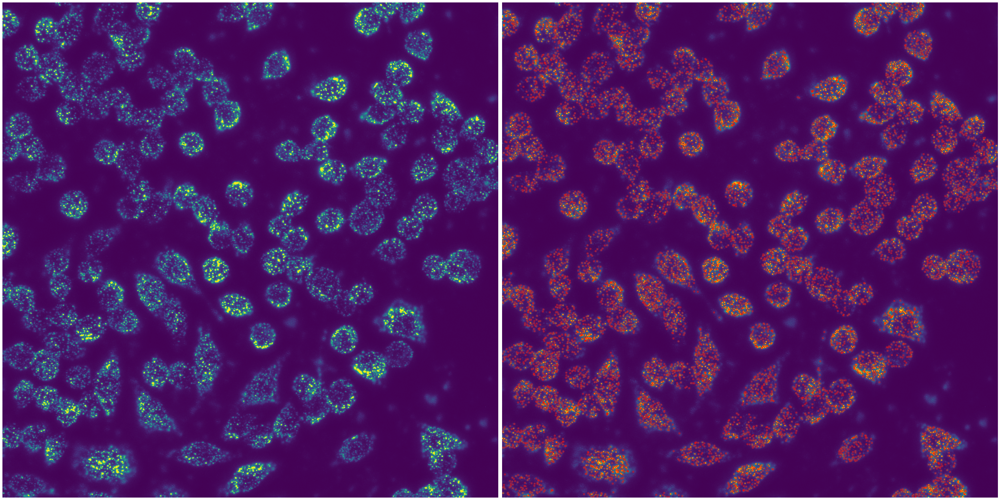

In [34]:
rs_spots = rsfish_analysis(RNA_2D)

In [44]:
fov_results = cell_extraction(nuc_label, rs_spots, RNA_2D)

detected spots (inside nuclei)
 shape: (6420, 2)
 dtype: float64 

detected spots (outside nuclei)
 shape: (5277, 2)
 dtype: float64
number of cells identified: 112


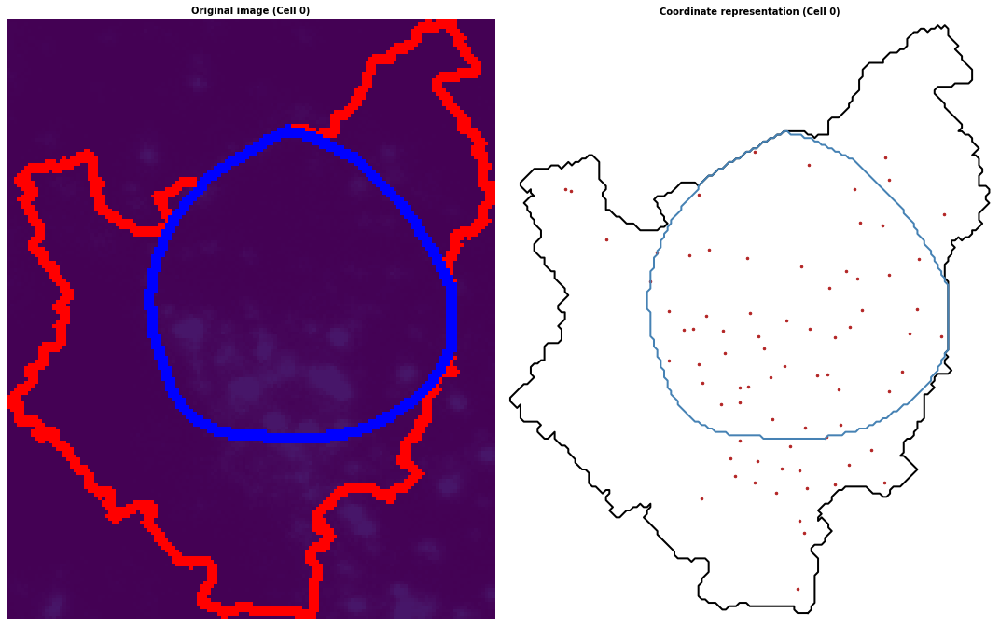

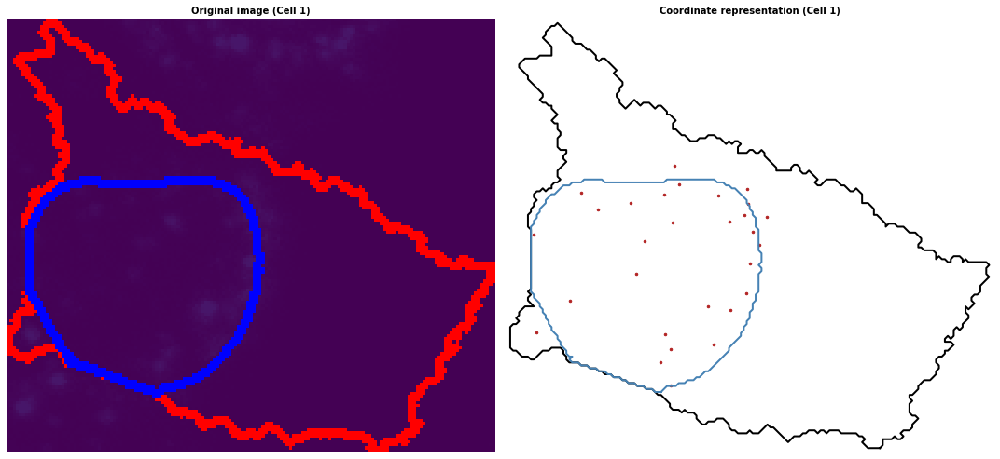

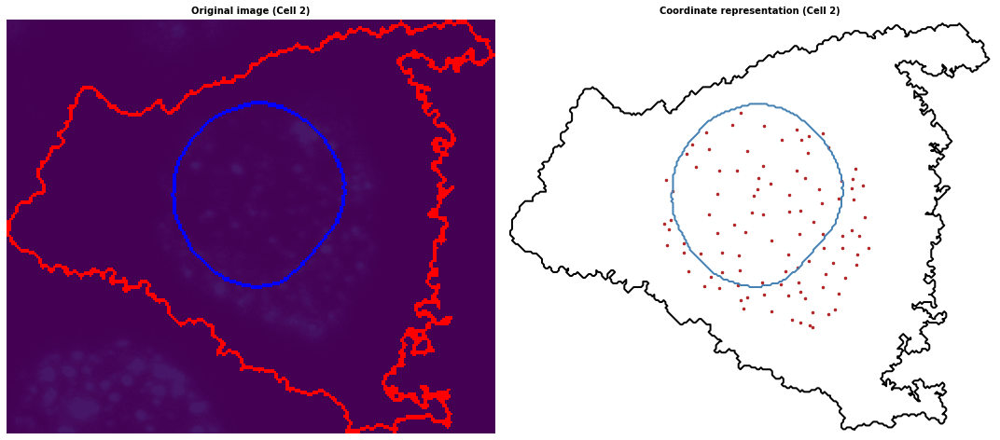

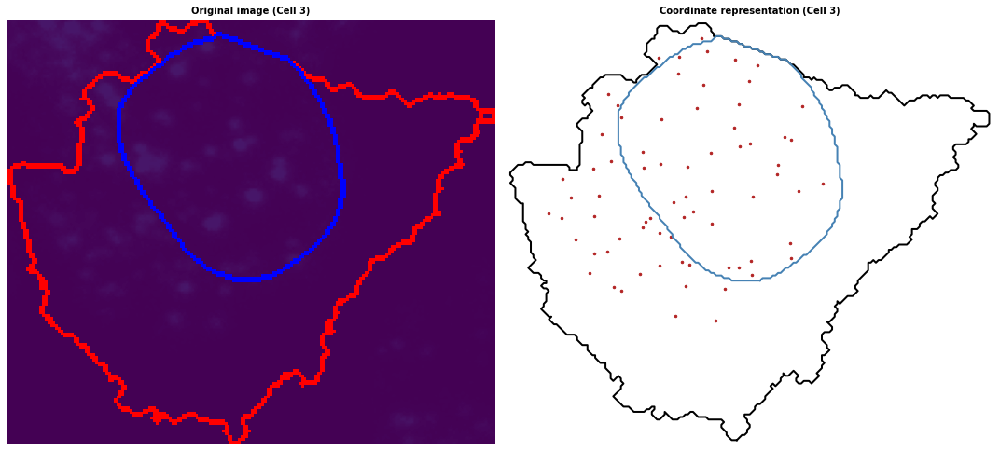

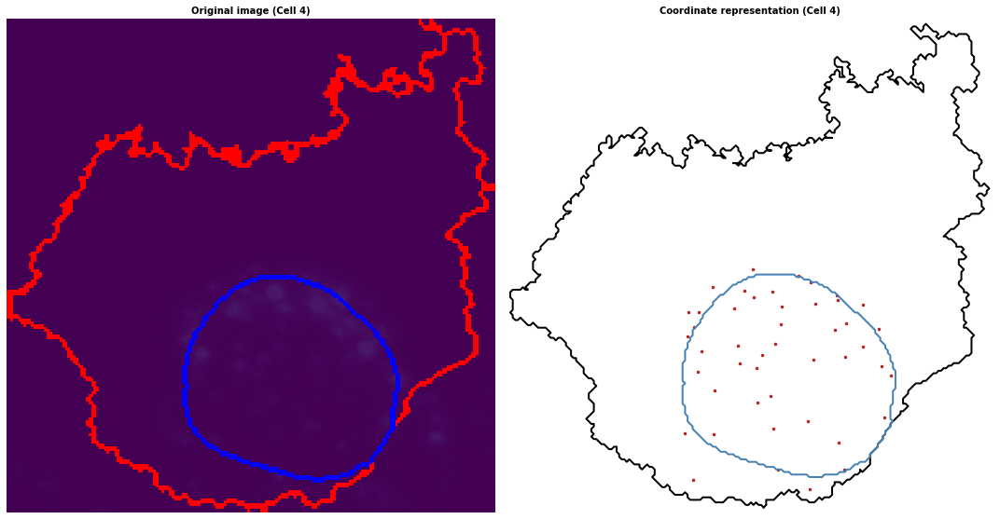

...

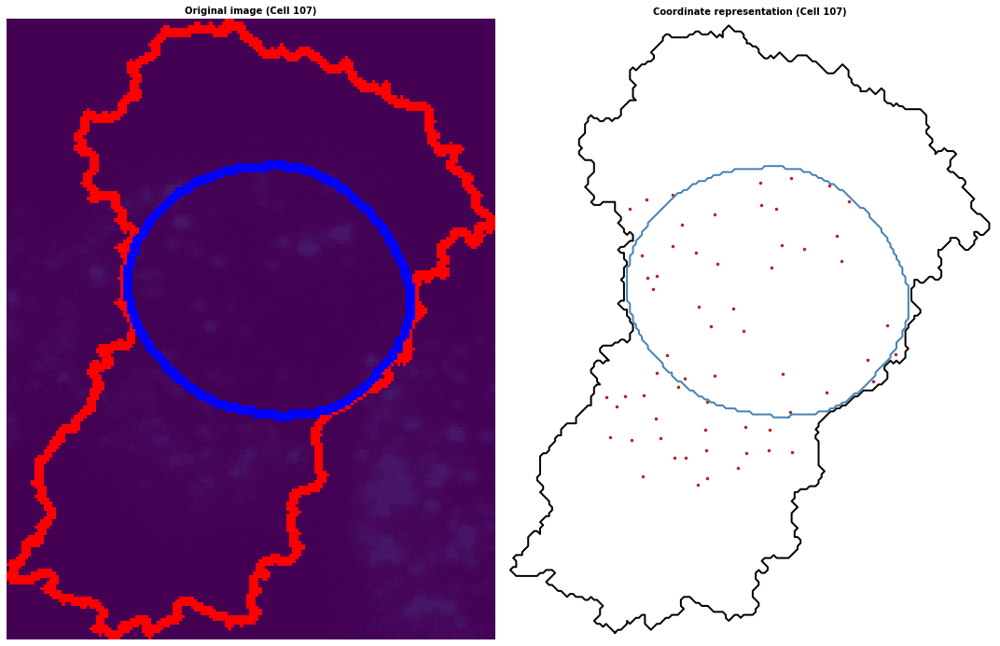

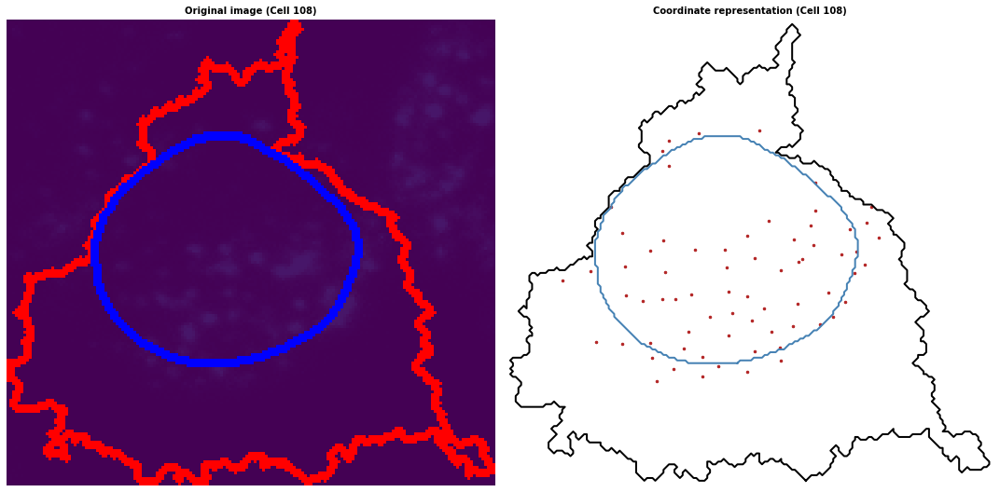

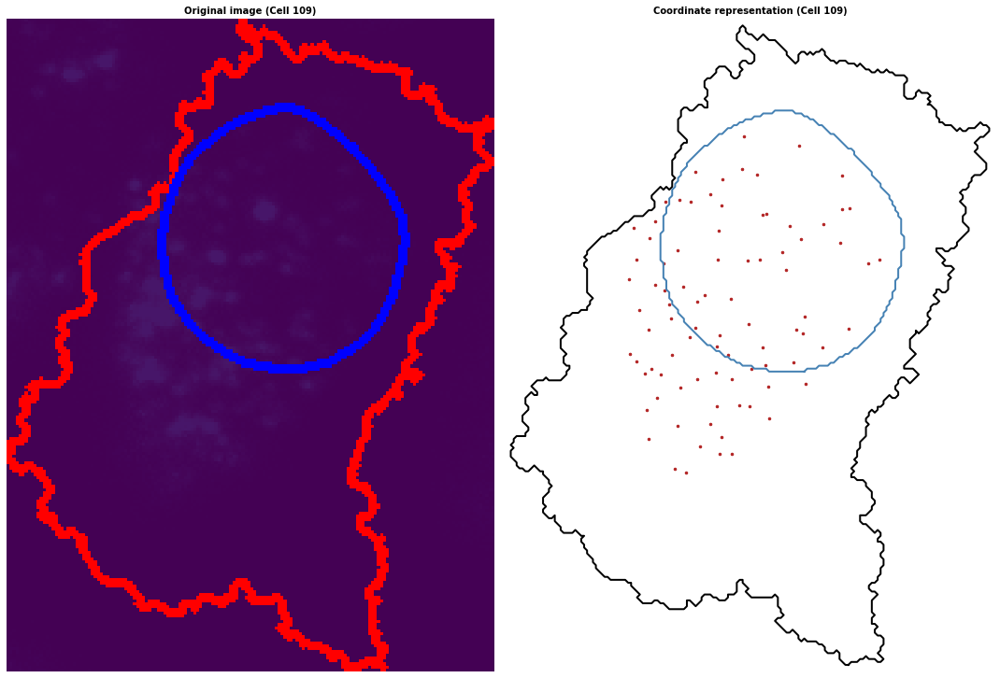

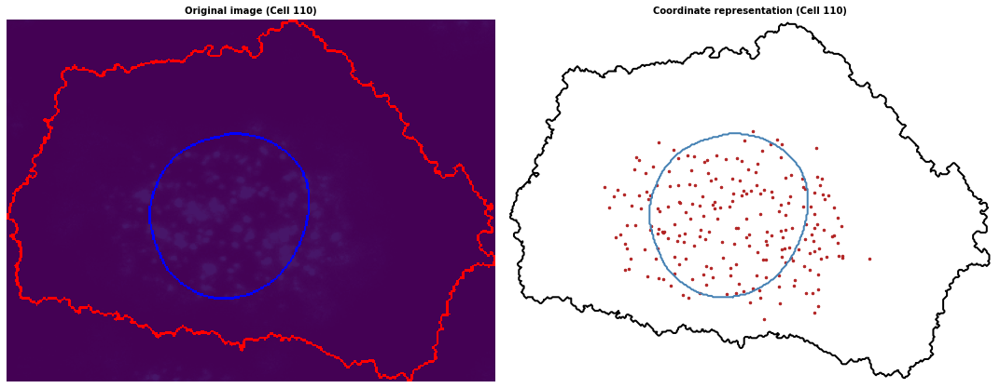

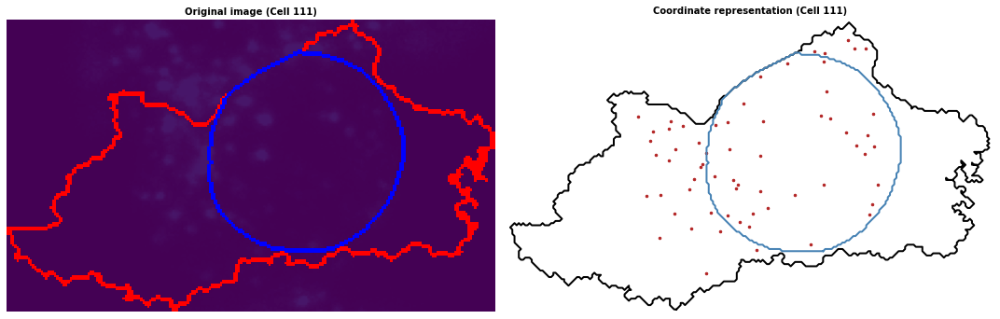

In [45]:
cell_level_visualization(fov_results)

In [68]:
spotCount(fov_results,img_name)

In [79]:
maxMinCount(fov_results,img_name)